# Analyse Exploratoire 1/2

## Sommaire :
* [Analyse exploratoire](#chapter1)
* [Fichier : application train](#chapter2)
* [Fusion 1 : Application train et Previous application](#chapter3)

In [1]:
#Importation des librairies de bases
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings("ignore")

In [2]:
app_train = pd.read_csv("data/application_train.csv")
app_test = pd.read_csv("data/application_test.csv")
prev_appli = pd.read_csv("data/previous_application.csv")

## Fichier : application train <a class="anchor" id="chapter1"></a>
On regarde plus en détail nos fichiers applications{train/test}

In [3]:
app_train.shape, app_test.shape

((307511, 122), (48744, 121))

On regarde les types de données et on peut voir que nous avons une colonne supplémentaire ("TARGET") qui se trouve dans le dataset "app_train" et pas dans "app_test".

In [4]:
app_train.dtypes.value_counts()

float64    65
int64      41
object     16
dtype: int64

On regarde la répartition de la valeur "TARGET". Cette valeur possède deux valeurs : 0 pour un client qui n'est pas en difficulté et 1 client en difficulté.<br>
Avec ce graphique, on peut voir que les clients en écrasante majorité ne sont pas en difficultés..

Text(0.5, 1.0, 'Répartion de la valeur TARGET')

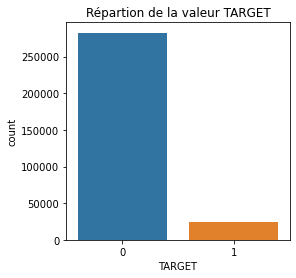

In [5]:
plt.rcParams["figure.figsize"] = (4, 4)
sns.countplot(data = app_train, x = "TARGET")
plt.title("Répartion de la valeur TARGET")

On va regarder la répartition du genre.<br>
Avec ce graphique, on peut voir que plus de femmes demandent de prêts.

Text(0.5, 1.0, 'Répartition du genre')

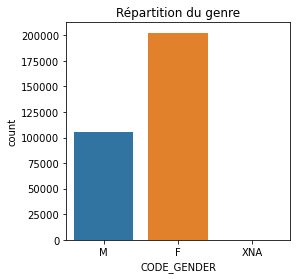

In [6]:
sns.countplot(data = app_train, x = "CODE_GENDER")
plt.title("Répartition du genre")

On va regarder le genre des demandeurs et regarder qui est en difficultés.<br>
Avec le graphique du dessus, on avait vu que les femmes faisaient le plus de prêts et donc on peut voir que la majorité des clientes n'ont pas de problèmes. Les clients en difficultés ne représentent pas un genre en particulier.

Text(0.5, 1.0, 'Répartition du genre par rapport à la valeur TARGET')

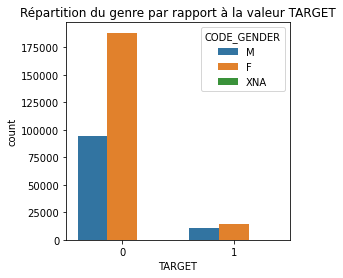

In [7]:
sns.countplot(data = app_train, x = 'TARGET', hue = "CODE_GENDER")
plt.title("Répartition du genre par rapport à la valeur TARGET")

Ensuite, on va regarder le nombre de client qui possède un bien immobilier et on peut constater que beaucoup ont déjà un bien immobillier et en majorité les femmes.

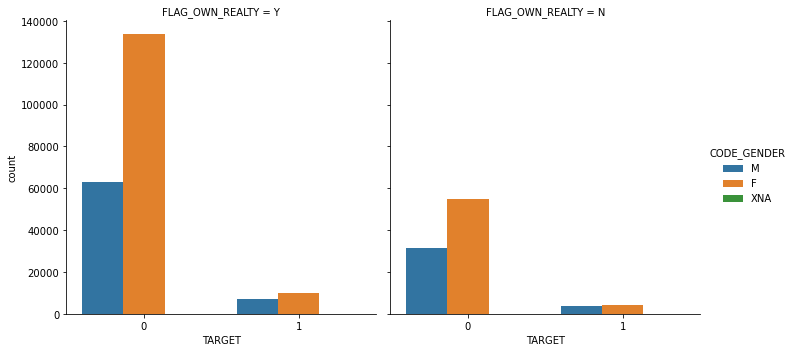

In [8]:
sns.catplot(data = app_train, x = 'TARGET', hue = "CODE_GENDER", col = 'FLAG_OWN_REALTY', kind="count")

On va regarder le type de contrat que le client à souscrit (prêt/renouveller) et séparer les clients en difficultés et voir si il possède un bien immobilier. On peut voir que beaucoup font un prêt et qui ont un bien immobilier et ceux qui possèdent pas de bien immobiler ont pris un prêt.

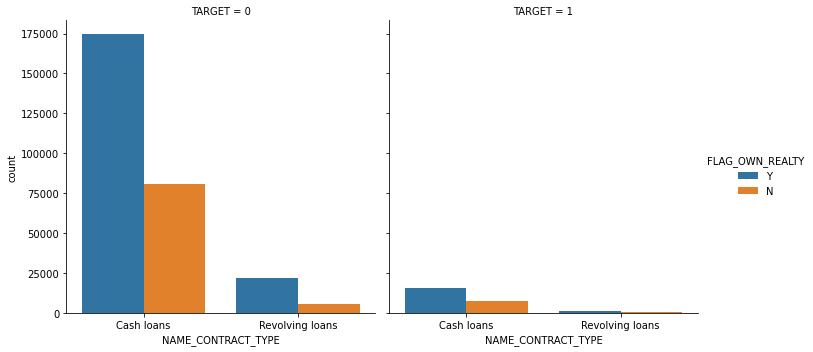

In [9]:
sns.catplot(data = app_train, col = 'TARGET', x = "NAME_CONTRACT_TYPE", hue = "FLAG_OWN_REALTY", kind="count")

Text(0.5, 1.0, 'Note des régions (1,2,3) ou le client vit')

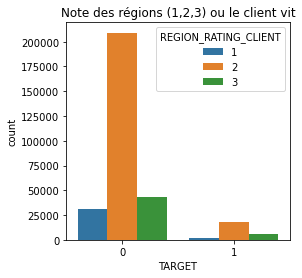

In [10]:
sns.countplot(data = app_train, x = 'TARGET', hue = "REGION_RATING_CLIENT")
plt.title("Note des régions (1,2,3) ou le client vit")

Pourcentage de la population ayant des diplômes

In [11]:
import plotly.express as px

plt.rcParams["figure.figsize"] = (5,5)
fig = px.pie(names = app_train['NAME_EDUCATION_TYPE'].value_counts().keys(),
        values = app_train['NAME_EDUCATION_TYPE'].value_counts().values,
        title = "Répartition des différents types de diplômes")
fig.update_traces(marker=dict(line=dict(width=2)))
fig.show()

Text(0.5, 1.0, 'Répartition des différents types de diplômes selon les TARGET')

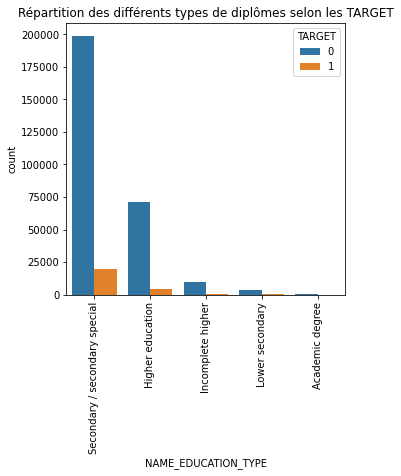

In [12]:
sns.countplot(data = app_train, x = 'NAME_EDUCATION_TYPE', hue = 'TARGET')
#plt.legend(bbox_to_anchor=(1.0, 1.0), loc='best')
plt.xticks(rotation=90)
plt.title("Répartition des différents types de diplômes selon les TARGET")

La majorité des clients qui demandent des prêts n'ont pas d'enfants.

Text(0.5, 1.0, 'Nombre enfant par clients')

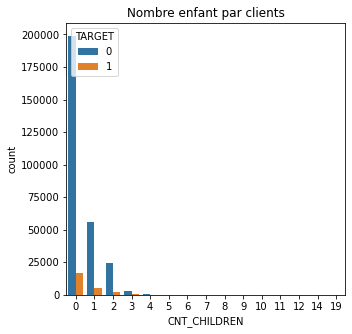

In [13]:
sns.countplot(data = app_train, x = "CNT_CHILDREN", hue = 'TARGET')
#plt.legend(bbox_to_anchor=(1.0, 1.0), loc='best')
plt.title("Nombre enfant par clients")

In [14]:
plt.rcParams["figure.figsize"] = (7,7)
fig = px.pie(names = app_train['NAME_FAMILY_STATUS'].value_counts().keys(),
        values = app_train['NAME_FAMILY_STATUS'].value_counts().values,
        title = "Statut du client")
fig.update_traces(marker=dict(line=dict(width=2)))
fig.show()

Text(0.5, 1.0, 'Situation du clients')

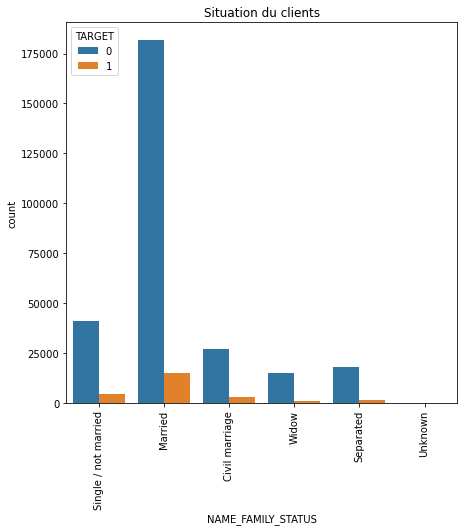

In [15]:
sns.countplot(data = app_train, x = 'NAME_FAMILY_STATUS', hue = 'TARGET')
#plt.legend(bbox_to_anchor=(1.0, 1.0), loc='best')
plt.xticks(rotation=90)
plt.title("Situation du clients")

On va voir la répartition des prêts par genre et on peut constater que les prêts sont proches.

Text(0.5, 1.0, 'Boxplot sur les crédits par rapport au genre et au TARGET')

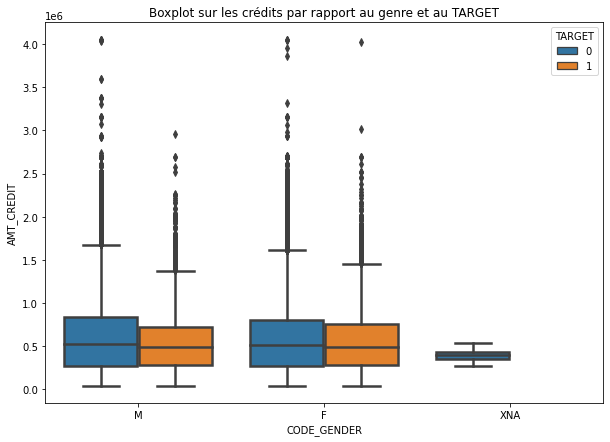

In [16]:
plt.rcParams["figure.figsize"] = (10,7)
sns.boxplot(data = app_train, x = 'CODE_GENDER', y = 'AMT_CREDIT', 
                hue='TARGET', linewidth=2.5)
plt.title("Boxplot sur les crédits par rapport au genre et au TARGET")

Revenu du client, on supprime les outliers pour plus de visibilités.

Text(0.5, 1.0, 'Boxplot sur les revenus des clients par rapport au genre et au TARGET')

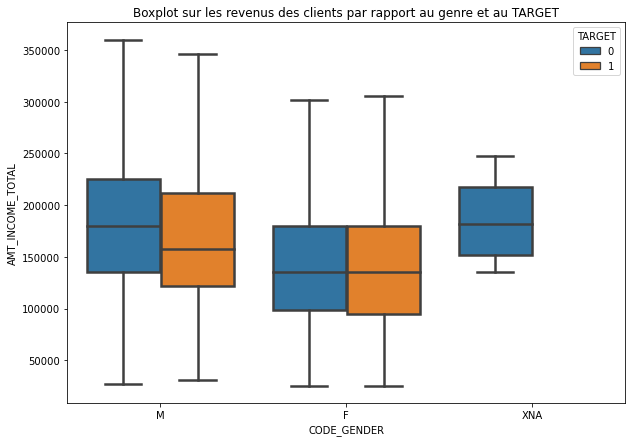

In [17]:
plt.rcParams["figure.figsize"] = (10,7)
sns.boxplot(data = app_train, x = 'CODE_GENDER', y = 'AMT_INCOME_TOTAL', 
                hue='TARGET', linewidth=2.5, showfliers=False)
plt.title("Boxplot sur les revenus des clients par rapport au genre et au TARGET")

On va afficher un camembert des métiers, pour les métiers qui sont peu représentés, on va les mettre dans la catégorie "Autres". On créait un dataframe, on fai la somme des lignes et on renomme la ligne à "Autres".<br>
Les valeurs "Autre" appartient :
- Unemployed
- Student
- Businessman
- Maternity leave 

In [18]:
df = pd.DataFrame()
df["labels"] = app_train['NAME_INCOME_TYPE'].value_counts().keys()
df["values"] = app_train['NAME_INCOME_TYPE'].value_counts().values
print("Ancien dataframe :")
print(df)
print("##################################################")
df[4:] = df[4:].sum()
df = df[:5]
df["labels"][4] = "Autres"
print("Nouveau dataframe :")
print(df)

Ancien dataframe :
                 labels  values
0               Working  158774
1  Commercial associate   71617
2             Pensioner   55362
3         State servant   21703
4            Unemployed      22
5               Student      18
6           Businessman      10
7       Maternity leave       5
##################################################
Nouveau dataframe :
                 labels  values
0               Working  158774
1  Commercial associate   71617
2             Pensioner   55362
3         State servant   21703
4                Autres      55


In [19]:
plt.rcParams["figure.figsize"] = (5,5)
fig = px.pie(df, values = df['values'],
             names = df['labels'],
             title = "Répartition des différents types de diplômes")
fig.update_traces(marker=dict(line=dict(width=2)))
fig.show()

Les différents métiers par rapport aux targets

Text(0.5, 1.0, 'Le type de métier par rapport au target')

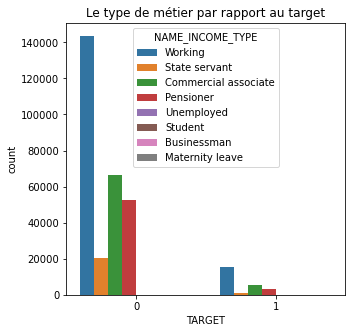

In [20]:
sns.countplot(data = app_train, x = 'TARGET', hue = 'NAME_INCOME_TYPE')
plt.title("Le type de métier par rapport au target")

In [21]:
fig = px.histogram(app_train, x="OCCUPATION_TYPE",
                  barmode='group', text_auto='.2s').update_xaxes(categoryorder = "total descending")
fig.update_traces(textfont_size=12, textangle=0, textposition="outside", cliponaxis=False)
fig.show()

In [22]:
fig = px.histogram(app_train, x="OCCUPATION_TYPE", 
                   color="TARGET", barmode='group').update_xaxes(categoryorder = "total descending")
fig.show()

In [23]:
fig = px.histogram(app_train, x="ORGANIZATION_TYPE", 
                   color="TARGET", barmode='group').update_xaxes(categoryorder = "total descending")
fig.show()

Text(0.5, 1.0, 'Boxplot sur le prix des biens pour lesquels le prêt est accordé par rapport au genre et au TARGET')

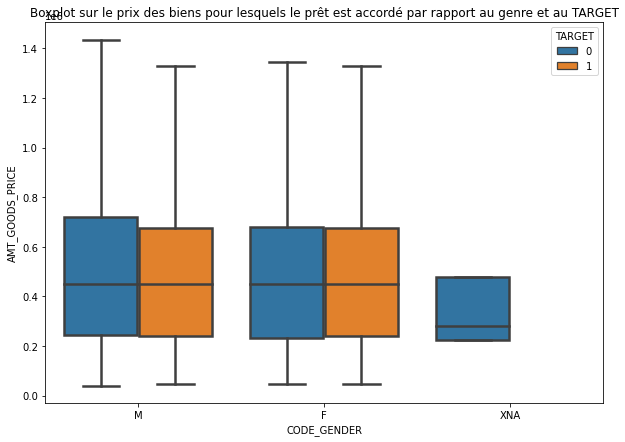

In [24]:
plt.rcParams["figure.figsize"] = (10,7)
sns.boxplot(data = app_train, x = 'CODE_GENDER', y = 'AMT_GOODS_PRICE', 
                hue='TARGET', linewidth=2.5, showfliers=False)
plt.title("Boxplot sur le prix des biens pour lesquels le prêt est accordé par rapport au genre et au TARGET")

Text(0.5, 1.0, 'Boxplot sur la rente demandé par rapport au genre et au TARGET')

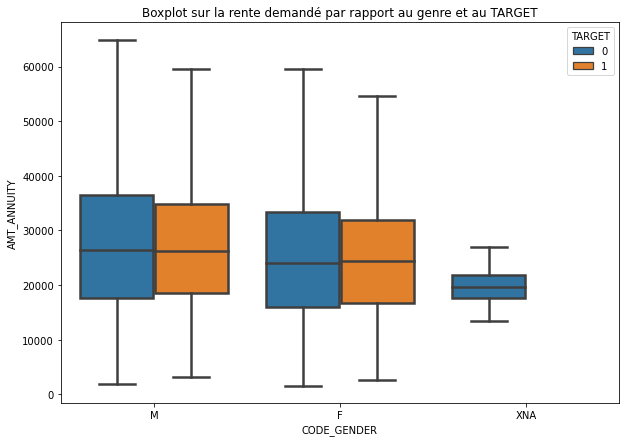

In [25]:
sns.boxplot(data = app_train, x='CODE_GENDER', y='AMT_ANNUITY', 
                hue='TARGET', linewidth=2.5, showfliers=False)
plt.title("Boxplot sur la rente demandé par rapport au genre et au TARGET")

## Fusion 1 : Application train et Previous application <a class="anchor" id="chapter3"></a>

In [26]:
join_1 = app_train.join(prev_appli, how='left', on='SK_ID_CURR', 
                                rsuffix='_previous')

join_1.head(3)

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,Connectivity,10.0,high,POS mobile with interest,365243.0,-2004.0,-1734.0,-1914.0,-1908.0,0.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,Connectivity,12.0,low_normal,POS mobile with interest,NaN,NaN,NaN,NaN,NaN,NaN
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,Connectivity,5.0,low_normal,POS mobile without interest,365243.0,-1308.0,-1188.0,-1188.0,-1181.0,0.0


In [27]:
plt.rcParams["figure.figsize"] = (7,7)
fig = px.histogram(join_1, x="NAME_CONTRACT_STATUS",
             color="TARGET", barmode='group').update_xaxes(categoryorder = "total descending")
fig.show()

In [28]:
df = pd.DataFrame()
df["labels"] = join_1['CODE_REJECT_REASON'].value_counts().keys()
df["values"] = join_1['CODE_REJECT_REASON'].value_counts().values
print("Ancien dataframe :")
print(df)
print("##################################################")
df[4:] = df[5:].sum()
df = df[:6]
df["labels"][5] = "Autres"
print("Nouveau dataframe :")
print(df)

Ancien dataframe :
   labels  values
0     XAP  249031
1      HC   32257
2   LIMIT   10518
3     SCO    6805
4  CLIENT    4853
5   SCOFR    2333
6     XNA     956
7   VERIF     611
8  SYSTEM     147
##################################################
Nouveau dataframe :
                labels  values
0                  XAP  249031
1                   HC   32257
2                LIMIT   10518
3                  SCO    6805
4  SCOFRXNAVERIFSYSTEM    4047
5               Autres    4047


In [29]:
plt.rcParams["figure.figsize"] = (5,5)
fig = px.pie(df, values = df['values'],
             names = df['labels'],
             title = "Répartition des différents raisons de rejets")
fig.update_traces(marker=dict(line=dict(width=2)))
fig.show()

In [30]:
fig = px.histogram(join_1, x="CODE_REJECT_REASON",
             color="TARGET", barmode='group').update_xaxes(categoryorder = "total descending")
fig.show()

In [31]:
import plotly.graph_objs as go
from plotly.offline import iplot

pie = go.Figure(data=[go.Pie(labels = join_1['NAME_PORTFOLIO'].value_counts().keys(),
                             values = join_1['NAME_PORTFOLIO'].value_counts().values)])

iplot(pie)

La suite de l'analyse exploratoire est dans le notebook suivant

In [32]:
join_1.to_csv("data/join_1.csv", index=False)